# **Trash classification model with Pseudo-labelling**

References:

*The Illustrated FixMatch for Semi-Supervised Learning
https://amitness.com/2020/03/fixmatch-semi-supervised/*

In [2]:
import os
import math
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import random
import shutil
from tqdm import tqdm
from time import time
import itertools
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, ConfusionMatrixDisplay, precision_recall_curve, average_precision_score, precision_score, recall_score, f1_score
# Display
from IPython.display import Image, display

import pickle
import matplotlib as mlp
import matplotlib.pyplot as plt

import keras

import gc

In [2]:
# from google.colab import drive
# drive.mount("/content/drive")

# Dataset Download (run only if data is not present)

**TrashNet Dataset**

In [9]:
! pip install kaggle --quiet

! mkdir ~/.kaggle
! cp "./kaggle.json" ~/.kaggle/ #api key
! chmod 600 ~/.kaggle/kaggle.json

! kaggle datasets download -d asdasdasasdas/garbage-classification # dataset path (copy paste from page kaggle)

! mkdir kaggle_data


mkdir: /Users/andreamancini/.kaggle: File exists
  2%|▉                                     | 2.00M/82.0M [00:00<00:30, 2.78MB/s]^C
  5%|█▊                                    | 4.00M/82.0M [00:01<00:21, 3.74MB/s]
User cancelled operation
mkdir: kaggle_data: File exists


**Gargage Dataset (Used as unlabel)**

In [4]:
! kaggle datasets download -d mostafaabla/garbage-classification

! unzip -q {"garbage-classification.zip"} -d kaggle_data
! rm -r "garbage-classification.zip"

 99%|███████████████████████████████████████▋| 237M/239M [00:06<00:00, 32.7MB/s]
100%|████████████████████████████████████████| 239M/239M [00:06<00:00, 36.6MB/s]


In [12]:
def fix_random_seed(seed):

    tf.keras.utils.set_random_seed(seed)
    np.random.seed(seed)
    random.seed(seed)

In [13]:
def get_dataset_from_dir(dir_path,img_dir,shuffle=False):
  """
  Return list of all images path with their corresponding label
  """
  x = []
  y = []

  for i, dir in enumerate(img_dir):

      dirfiles = os.listdir(dir_path+'/'+dir)
      print(dir)

      for file_i in tqdm(dirfiles):
        fname = dir_path +'/'+dir+'/'+file_i
        x.append(fname)
        y.append(i) #label corresponding to dir position on parent folder

  x = np.stack(x, axis=0)
  y = np.stack(y, axis=0)

  if shuffle:
    idx = np.random.permutation(len(x))

    x,y = x[idx], y[idx]

  return x,y

def load_images_dataset(imgpath, img_size):

  """
  Load image from disk
  """
  img = tf.io.read_file(imgpath)
  img = tf.io.decode_jpeg(img, channels=3)
  img = tf.image.resize(img,[img_size[0],img_size[1]])

  return img

def configure_for_performance(ds):
  ds = ds.cache()
  ds = ds.prefetch(buffer_size=tf.data.AUTOTUNE)
  return ds

def get_undersample_idx(y_array):
  """
  Return two list of indices from array taken in input. Minority is the list of indices balanced
  by undersampling.
  """
  majority_idx = {}
  int_labels = np.argmax(y_array, axis=1)

  for label in np.unique(int_labels):

      majority_idx[label] = np.where(int_labels == label)[0]

  min_pseudo = (None, 9999)

  for key, value in majority_idx.items():

      if(len(value) < min_pseudo[1]):
          min_pseudo = (key, len(value))

  under_sampled_idx = {}

  for key, value in majority_idx.items():

      under_sampled_idx[key] = value[:min_pseudo[1]]

      if(key != min_pseudo[0]):
          majority_idx[key] = value[min_pseudo[1]:]
      else:
          majority_idx[key] = []

  concat_minority_idx = []

  for array in under_sampled_idx.values():
      concat_minority_idx.extend(array)

  concat_majority_idx = []

  for array in majority_idx.values():
      concat_majority_idx.extend(array)

  return concat_minority_idx, concat_majority_idx

In [19]:
img_dir = os.listdir('kaggle_data/garbage-classification/Garbage classification/Garbage classification')
img_path = 'kaggle_data/garbage-classification/Garbage classification/Garbage classification'

if 'trash' in img_dir:
  shutil.rmtree(os.path.join(img_path,'trash'))
  img_dir.remove('trash')

print(img_dir)

['paper', 'metal', 'cardboard', 'glass', 'plastic']


In [20]:
#We merge all glass type elements into glass

img_dir2 = os.listdir('kaggle_data/garbage_classification')
img_path2 = 'kaggle_data/garbage_classification'

if img_dir2 != ['paper', 'metal', 'cardboard', 'glass', 'plastic']:
  for dir in ['battery','biological','clothes','shoes','trash']:

    if dir in img_dir2:
      shutil.rmtree(os.path.join(img_path2,dir))
      img_dir2.remove(dir)

  print(img_dir2)

  def merge_directories(src_dirs, dest_dir):
      for src_dir in src_dirs:
          for root, dirs, files in os.walk(src_dir):
              for file in files:
                  src_file_path = os.path.join(root, file)
                  dest_file_path = os.path.join(dest_dir, file)

                  # Ensure the destination directory exists
                  os.makedirs(os.path.dirname(dest_file_path), exist_ok=True)

                  # Copy the file to the destination directory
                  shutil.copy2(src_file_path, dest_file_path)

  glass_dirs = [os.path.join(img_path2, dir) for dir in ['white-glass', 'brown-glass', 'green-glass']]
  merge_directories(glass_dirs, os.path.join(img_path2, 'glass'))

  for dir in ['white-glass', 'brown-glass', 'green-glass']:
    shutil.rmtree(os.path.join(img_path2,dir))
    img_dir2.remove(dir)

  img_dir2 = os.listdir('kaggle_data/garbage_classification')
  print(img_dir2)

# **Split the data**


In [21]:
IMG_SIZE = (160, 160)
onehot_dict = {}
NUMLABELS = len(img_dir)
CLASSLABELS = img_dir.copy()

seed = 42

fix_random_seed(seed)

for i,label in enumerate(CLASSLABELS): onehot_dict[i] = label

In [22]:
x_path, labels = get_dataset_from_dir(img_path, img_dir)

onehot_labels = tf.one_hot(labels,depth=NUMLABELS).numpy()

train_path, basetest_path, y_train, y_basetest = train_test_split(x_path, onehot_labels, test_size=0.17, random_state=seed)

train_path, val_path, y_train, y_val = train_test_split(train_path, y_train, test_size=0.13/(1.0-0.17), random_state=seed)

train_ds = tf.data.Dataset.from_tensor_slices((train_path, y_train))
train_ds = train_ds.map(lambda x,y: (load_images_dataset(x,IMG_SIZE),y))
train_ds = train_ds.shuffle(seed = seed,buffer_size=1000)

val_ds = tf.data.Dataset.from_tensor_slices((val_path, y_val))
val_ds = val_ds.map(lambda x,y: (load_images_dataset(x,IMG_SIZE),y))

basetest_ds = tf.data.Dataset.from_tensor_slices((basetest_path, y_basetest))
basetest_ds = basetest_ds.map(lambda x,y: (load_images_dataset(x,IMG_SIZE),y))

paper


100%|██████████| 594/594 [00:00<00:00, 1811939.33it/s]


metal


100%|██████████| 410/410 [00:00<00:00, 2081918.45it/s]


cardboard


100%|██████████| 403/403 [00:00<00:00, 2726297.60it/s]


glass


100%|██████████| 501/501 [00:00<00:00, 3232840.47it/s]


plastic


  0%|          | 0/482 [00:00<?, ?it/s]

100%|██████████| 482/482 [00:00<00:00, 2900508.65it/s]


In [23]:
x_path1, labels1 = get_dataset_from_dir(img_path, img_dir)
x_path2, labels2 = get_dataset_from_dir(img_path2, img_dir)

x_path = x_path1
labels = labels1

onehot_labels = tf.one_hot(labels,depth=NUMLABELS).numpy()

unlabel_path = x_path2
y_unlabel = tf.one_hot(labels2,depth=NUMLABELS).numpy()

unlabel_path, u_test_path, y_unlabel, y_u_test = train_test_split(unlabel_path, y_unlabel, test_size=0.2, random_state=seed)

u_ratio = len(y_unlabel) // len(y_train)

len_u = len(y_train) * u_ratio  

unlabel_path = unlabel_path[:len_u]
y_unlabel = y_unlabel[:len_u]


test_path = np.concatenate((basetest_path, u_test_path, unlabel_path[len_u:]))
y_test = np.concatenate((y_basetest,y_u_test,y_unlabel[len_u:]))

test_ds = tf.data.Dataset.from_tensor_slices((test_path, y_test))
test_ds = test_ds.map(lambda x,y: (load_images_dataset(x,IMG_SIZE),y))

unlabel_ds = tf.data.Dataset.from_tensor_slices((unlabel_path))
unlabel_ds = unlabel_ds.map(lambda x: load_images_dataset(x,IMG_SIZE))

paper


100%|██████████| 594/594 [00:00<00:00, 2151482.36it/s]


metal


100%|██████████| 410/410 [00:00<00:00, 3081836.27it/s]


cardboard


100%|██████████| 403/403 [00:00<00:00, 2726297.60it/s]


glass


100%|██████████| 501/501 [00:00<00:00, 2216610.03it/s]


plastic


100%|██████████| 482/482 [00:00<00:00, 3341577.73it/s]


paper


100%|██████████| 1050/1050 [00:00<00:00, 3932160.00it/s]


metal


100%|██████████| 769/769 [00:00<00:00, 3981999.72it/s]


cardboard


100%|██████████| 891/891 [00:00<00:00, 3278179.71it/s]


glass


100%|██████████| 2011/2011 [00:00<00:00, 4892543.70it/s]


plastic


100%|██████████| 865/865 [00:00<00:00, 4621748.99it/s]


In [24]:
def get_split_count(splitlabel):
  """
  Count elements for each dataset
  """
  split_info = {}
  intlabels = np.argmax(splitlabel, axis=1)

  foundlabels, countlabels = np.unique(intlabels,axis=0,return_counts=True)

  for i,label in enumerate(foundlabels):
    split_info[CLASSLABELS[label]] = countlabels[i]

  return split_info

def get_dataset_info(data):
  """
  Count number of class elements for each dataset
  """
  train_val_test_len = {}
  
  y_train, y_val, y_basetest,y_test, y_unlabel = data
  train_val_test_len = {  "train": len(y_train),
                          "val": len(y_val),
                          "basetest": len(y_basetest),
                          "test": len(y_test),
                          "unlabel": len(y_unlabel)
                          }


  dataset_info = {  'train': get_split_count(y_train),
                    'val': get_split_count(y_val),
                    'basetest': get_split_count(y_basetest),
                    'test': get_split_count(y_test),
                    'unlabel': get_split_count(y_unlabel),
                    }

  return train_val_test_len, dataset_info

train_val_test_len, dataset_info = get_dataset_info((y_train, y_val, y_basetest, y_test, y_unlabel))

print(train_val_test_len)
dataset_info

{'train': 1672, 'val': 311, 'basetest': 407, 'test': 1525, 'unlabel': 3344}


{'train': {'paper': 413,
  'metal': 295,
  'cardboard': 279,
  'glass': 349,
  'plastic': 336},
 'val': {'paper': 78,
  'metal': 48,
  'cardboard': 48,
  'glass': 67,
  'plastic': 70},
 'basetest': {'paper': 103,
  'metal': 67,
  'cardboard': 76,
  'glass': 85,
  'plastic': 76},
 'test': {'paper': 333,
  'metal': 228,
  'cardboard': 243,
  'glass': 476,
  'plastic': 245},
 'unlabel': {'paper': 629,
  'metal': 470,
  'cardboard': 544,
  'glass': 1194,
  'plastic': 507}}

# Define the datasets

In [26]:
BATCH_SIZE = 32

batched_train_ds = configure_for_performance(train_ds.batch(BATCH_SIZE))

# Test set TrashNet
batched_basetest_ds = configure_for_performance(basetest_ds.batch(BATCH_SIZE))

# Test set TrashNet + Garbage Dataset
batched_test_ds = configure_for_performance(test_ds.batch(BATCH_SIZE))
batched_val_ds = configure_for_performance(val_ds.batch(BATCH_SIZE))

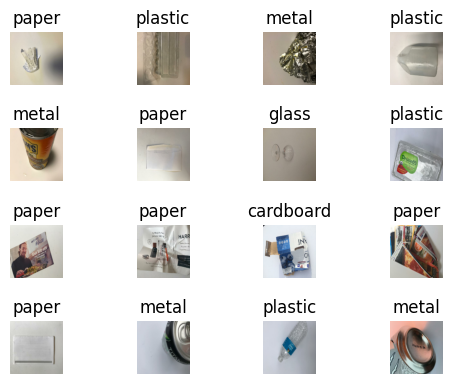

In [11]:
x, y = next(iter(train_ds.batch(32)))

for i in range(0,len(y),2):

    plt.subplot(4, 8, i + 1)
    plt.imshow(x[i].numpy().astype("uint8"))
    plt.title(onehot_dict[np.argmax(y[i])])
    plt.axis("off")

plt.show()

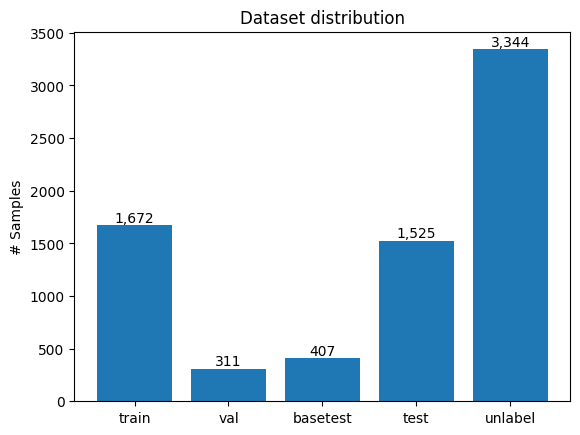

In [26]:
plot = plt.bar(list(train_val_test_len.keys()),list(train_val_test_len.values()))
plt.title('Dataset distribution')
plt.ylabel('# Samples')

plt.bar_label(plot, fmt='{:,.0f}')

plt.show()

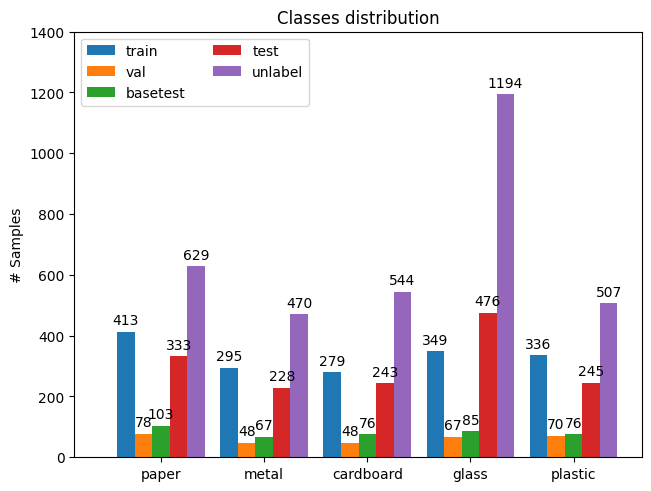

In [27]:
x = np.arange(5)
width = 0.17
multiplier = 0
fig, ax = plt.subplots(layout='constrained')

for attribute in dataset_info.keys():
    offset = width * multiplier
    rects = ax.bar(x + offset , list(dataset_info[attribute].values()), width, label=attribute)
    ax.bar_label(rects, padding=3)
    multiplier += 1

ax.set_ylabel('# Samples')
ax.set_title('Classes distribution')
ax.set_xticks(x + width*2, dataset_info['train'].keys())
ax.legend(loc='upper left', ncols=2)
ax.set_ylim(0, 1400)
ax.set_xlim(-0.5,5)


plt.show()

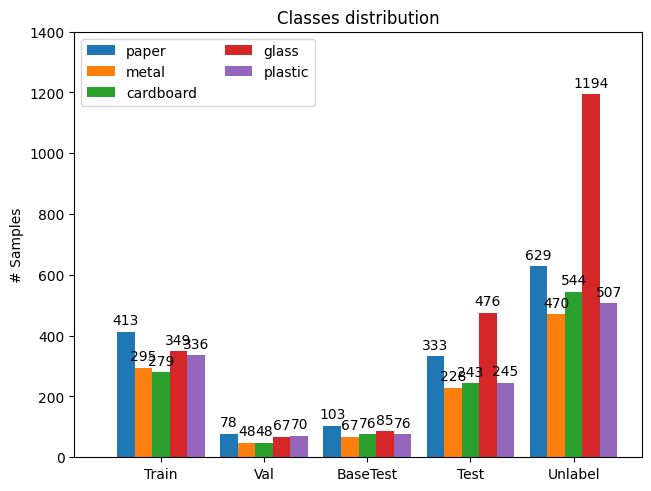

In [30]:
x = np.arange(5)  # the label locations
width = 0.17
multiplier = 0
fig, ax = plt.subplots(layout='constrained')

new_dict = dict()

for value in dataset_info.keys():
    for att in dataset_info[value]:
      if att not in new_dict:
        new_dict.update({att: dict()})

      new_dict[att].update({value : dataset_info[value][att]})

for attribute in new_dict.keys():
    offset = width * multiplier
    rects = ax.bar(x + offset , list(new_dict[attribute].values()), width, label=attribute)
    ax.bar_label(rects, padding=3)
    multiplier += 1

ax.set_ylabel('# Samples')
ax.set_title('Classes distribution')
ax.set_xticks(x + width*2, ["Train","Val","BaseTest","Test","Unlabel"])
ax.legend(loc='upper left', ncols=2)
ax.set_ylim(0, 1400)
ax.set_xlim(-0.5,5)

plt.show()

# Model Definition

We use MobileNetV2 as backbone of our model to exploit its learned knowledge as feature extractor from a much larger dataset as ImageNet. At the top of it we attached a simple classifier with a Dropout Layer

In [6]:
def initMobileNet():
  # Create the base model from the pre-trained model MobileNet V2
  IMG_SHAPE = IMG_SIZE + (3,)

  base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               weights='imagenet')

  base_model.trainable = False  #freeze backbone
  return base_model,IMG_SHAPE

In [7]:
def addClassifier(base_model,IMG_SHAPE,NUMLABELS):
  preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input

  inputs = tf.keras.Input(shape=IMG_SHAPE)
  x = preprocess_input(inputs)
  x = base_model(x, training=False)
  x = tf.keras.layers.GlobalAveragePooling2D()(x)
  x = tf.keras.layers.Dropout(0.2)(x)
  outputs = tf.keras.layers.Dense(NUMLABELS, activation="softmax")(x)
  model = tf.keras.Model(inputs, outputs)

  return model

# **Augmentation of Unlabelled Images**
Two sets of augmentations gets applied to unlabelled images, one weak and one strong one. The weak ones will be used for identifying the pesudo labels by predicting the labels through the pre-trained classifier on labelled data and the strong augmented ones will be used as images used for training the classifier.

In [16]:
from imgaug import augmenters as iaa

In [17]:
weak_aug = iaa.Sequential([
    iaa.Sometimes(1.0, iaa.GaussianBlur((0.5, 0.6))),
    iaa.Sometimes(0.8, iaa.Affine(rotate=(-5, 5))),
    iaa.Fliplr(0.5),
    iaa.Flipud(0.5) 
],
random_order=True
)

strong_aug = iaa.Sequential([
    iaa.Dropout((0.01, 0.1), per_channel=0.5),
    iaa.Sometimes(0.8, iaa.Affine(rotate=(-25, 25))),
    iaa.Sometimes(0.5, iaa.Affine(
        scale={"x": (0.8, 1.2), "y": (0.8, 1.2)},
        translate_percent={"x": (-0.2, 0.2), "y": (-0.2, 0.2)},
        rotate=(-25, 25),
        shear=(12, 15)
    ))
],
random_order=True
)
x_train_unlabelled_weak = []
x_train_unlabelled_strong = []

def augment_weak(images):
    img_dtype = images.dtype
    img_shape = tf.shape(images)
    images = tf.numpy_function(weak_aug.augment_image,
                                [images],
                                img_dtype)
    images = tf.reshape(images, shape = img_shape)
    return images

def augment_strong(images):
    img_dtype = images.dtype
    img_shape = tf.shape(images)
    images = tf.numpy_function(strong_aug.augment_image,
                                [images],
                                img_dtype)
    images = tf.reshape(images, shape = img_shape)
    return images

In [18]:
unlabel_aug_ds = unlabel_ds.map(lambda x: (augment_weak(x), augment_strong(x)))

batched_unlabel_aug_ds = configure_for_performance(unlabel_aug_ds.batch(BATCH_SIZE*u_ratio))

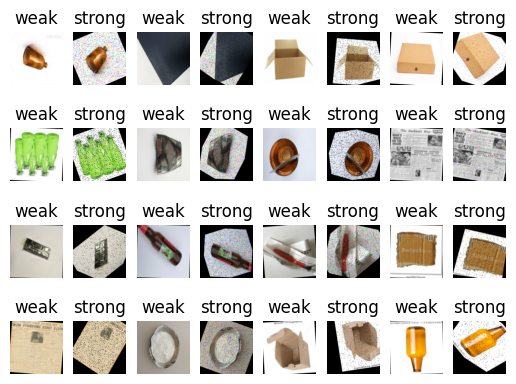

In [17]:
img_w, img_s = next(iter(unlabel_aug_ds.batch(32)))
# Iterate over images in the batch
for i in range(0,len(img_w),2):
    # Display each image in the batch
    plt.subplot(4, 8, i + 1)
    plt.imshow(img_w[i].numpy().astype("uint8"))
    plt.title("weak")
    plt.axis("off")
    plt.subplot(4, 8, i + 2)
    plt.imshow(img_s[i].numpy().astype("uint8"))
    plt.title("strong")
    plt.axis("off")

plt.show()

## **Self-Train Class**

We apply the FixMatch algorithm to train our model in a self-supervised way

(aggiungere immagine dell'algoritmo)

In [31]:
class TrainerModel():

    def __init__(self, u_weight, u_ratio, name=None, threshold=0.9):

        self.u_ratio = u_ratio
        self.u_weight = u_weight
        self.threshold = threshold

        if name is not None:
            self.ckpt_dir = f"checkpoints/checkpoints_{name}"
        else:
            self.ckpt_dir = f"checkpoints"
        
        if os.path.exists(self.ckpt_dir):
            shutil.rmtree(self.ckpt_dir, ignore_errors=True)
        
        os.makedirs(self.ckpt_dir, exist_ok=True)

    @classmethod
    def interleave(self, x, batch):
        s = x.get_shape().as_list()
        return tf.reshape(tf.transpose(tf.reshape(x, [-1, batch] + s[1:]), [1, 0] + list(range(2, 1+len(s)))), [-1] + s[1:])

    @classmethod
    def de_interleave(self, x, batch):
        s = x.get_shape().as_list()
        return tf.reshape(tf.transpose(tf.reshape(x, [batch, -1] + s[1:]), [1, 0] + list(range(2, 1+len(s)))), [-1] +s[1:])

    @tf.function
    def train_step(self, x_labeled, y_labeled, x_u_weak, x_u_strong):
        
        with tf.GradientTape() as tape:
            
            # concatenate all batches and shuffle it in a deterministic way in order
            # to transform back to original order after feed forward
            batch_x = self.interleave(tf.concat([x_labeled,x_u_weak,x_u_strong],0), 2 * self.u_ratio + 1)

            batch_pred = self.model(batch_x, training=True)

            batch_pred = self.de_interleave(batch_pred, 2 * self.u_ratio + 1)

            #calculate loss on labeled batch
            len_label = y_labeled.shape[0]
            loss_labeled = tf.keras.losses.CategoricalCrossentropy()(y_labeled, batch_pred[:len_label])
            
            # divide prediction from weak batch and strong batch
            pred_weak, pred_strong = tf.split(batch_pred[len_label:], 2)

            # mask predictions lower than threshold
            mask_weak = tf.reduce_max(pred_weak, axis=1) >= self.threshold
            mask_weak = tf.cast(mask_weak, tf.float32)

            len_unlabel = tf.math.count_nonzero(mask_weak, dtype=tf.float32)

            # pseudo labeling creation
            pseudo_label = tf.one_hot(tf.argmax(pred_weak, axis=1), depth=NUMLABELS, dtype=tf.float32)

            # loss calculated only on strong images prediction over pseudo labels coming from weak ones. We mask out images lower than threshold
            loss_unlabeled = tf.keras.losses.CategoricalCrossentropy(reduction='none')(pseudo_label, pred_strong) * mask_weak
            loss_unlabeled = tf.reduce_mean(loss_unlabeled)

            # final loss is the sum of label loss and unlabel loss weighted (1.0 take it)
            final_loss = loss_labeled + (self.u_weight * loss_unlabeled)


        grads = tape.gradient(final_loss, self.model.trainable_weights)
        self.optimizer.apply_gradients(zip(grads, self.model.trainable_weights))

        self.train_acc_metric.update_state( tf.concat([y_labeled,pseudo_label],0),
                                        tf.concat([batch_pred[:len_label],pred_strong],0),
                                        sample_weight=tf.concat([tf.ones(len_label),mask_weak],0)
                                        )
        step_samples = tf.cast(len_label+len_unlabel, dtype=tf.float32)


        return final_loss, step_samples, len_unlabel

    @tf.function
    def test_step(self, x_batch, y_batch):

        batch_pred = self.model(x_batch, training=False)

        loss = keras.losses.CategoricalCrossentropy()(y_batch, batch_pred)

        self.val_acc_metric.update_state(y_batch,batch_pred)

        return loss

    def fit(self, model, epochs, optimizer, labeled_ds, val_ds, unlabeled_ds=None):

        self.model = model
        self.optimizer = optimizer

        self.train_acc_metric = keras.metrics.CategoricalAccuracy()
        self.val_acc_metric = keras.metrics.CategoricalAccuracy()

        #collect loss and metrics
        train_loss_list = []
        train_acc_list = []

        val_loss_list = []
        val_acc_list = []

        start_time = time()

        best_val = 0.

        wait = 0
        patience = 5

        for epoch in range(epochs):

            train_loss = 0.
            train_samples = 0.
            
            len_unlabel_epoch = 0
            for _, ((x_labeled, y_labeled),(x_u_weak, x_u_strong)) in enumerate(zip(labeled_ds,unlabeled_ds)):

                loss, step_sample, len_unlabel = self.train_step(x_labeled, y_labeled, x_u_weak, x_u_strong)

                len_unlabel_epoch += len_unlabel.numpy()
                
                train_loss += loss * step_sample
                train_samples += step_sample

            print(f"unlabel over {self.threshold}: {len_unlabel_epoch}")
            train_loss /= train_samples
            train_loss_list.append(train_loss.numpy())


            train_acc = self.train_acc_metric.result()
            train_acc_list.append(train_acc.numpy())

            self.train_acc_metric.reset_states()

            val_loss = 0.
            val_samples = 0

            for _, (x_batch, y_batch) in enumerate(val_ds):

                loss = self.test_step(x_batch, y_batch)

                val_loss += loss * x_batch.shape[0]
                val_samples += x_batch.shape[0]

            val_loss /= float(val_samples)
            val_loss_list.append(val_loss.numpy())

            val_acc = self.val_acc_metric.result()
            val_acc_list.append(val_acc.numpy())
            self.val_acc_metric.reset_states()

            wait += 1
            if val_acc > best_val:
                best_val = val_acc
                
                wait = 0
                ckpt_name = f"ckpt_epoch{epoch}_val_{best_val:.4f}_.h5"

                self.model.save_weights(os.path.join(self.ckpt_dir, ckpt_name))
                print(ckpt_name)

            # Display metrics at the end of each epoch.
            print(  f"Epoch: {epoch} - Train loss[{train_loss:.4f}] - Train acc[{train_acc:.2f}]"
                    f" -- Val loss[{val_loss:.4f}] - Val acc[{val_acc:.2f}] - "
                    f"lr: {self.optimizer.learning_rate.numpy() :.7f}" if hasattr(self.optimizer.learning_rate, 'numpy') else ''
                    )

            if wait >= patience:
                break
        time_loop = time() - start_time

        #print(f"Time taken: {time_loop}")
        
        return {'train_loss': train_loss_list,
                'val_loss': val_loss_list,
                'train_acc_values': train_acc_list,
                'val_acc_values': val_acc_list,
                'time': time_loop }

# Train with only TrashNet Dataset

In [ ]:
"""
Overall best hyperparams

epochs = 20
l_rate = 1e-4
weight_decay=5e-3
use_ema=True
ema_momentum=0.999
optimizer = tf.keras.optimizers.Adam
"""

In [35]:
epochs = 100

lr = 1e-4

total_steps = (len(train_path) // BATCH_SIZE) * epochs

base_model,img_shape = initMobileNet()
model = addClassifier(base_model,img_shape,NUMLABELS)

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=5)
lr_scheduler = tf.keras.optimizers.schedules.CosineDecay(lr/10,
                                        decay_steps=total_steps * 0.9,
                                        alpha=1e-5/lr,
                                        warmup_steps=total_steps * 0.1,
                                        warmup_target=lr)

model.compile(optimizer=tf.keras.optimizers.Adam(lr_scheduler, weight_decay=5e-6),
            loss=tf.keras.losses.CategoricalCrossentropy(),
            metrics=[tf.keras.metrics.CategoricalAccuracy(name='accuracy')])

history = model.fit(batched_train_ds,
                epochs=epochs,
                validation_data=batched_val_ds,
                verbose=1,
                callbacks=[early_stopping]
                )

model.save_weights("checkpoints/baseline_ckpt.h5")

Epoch 1/100


2024-02-07 11:08:08.847101: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


53/53 [==============================] - 4s 55ms/step - loss: 2.3380 - accuracy: 0.1717 - val_loss: 2.1750 - val_accuracy: 0.1768
Epoch 2/100
53/53 [==============================] - 2s 36ms/step - loss: 2.1282 - accuracy: 0.1860 - val_loss: 1.9433 - val_accuracy: 0.2122
Epoch 3/100
53/53 [==============================] - 2s 36ms/step - loss: 1.9277 - accuracy: 0.2291 - val_loss: 1.7455 - val_accuracy: 0.2637
Epoch 4/100
53/53 [==============================] - 2s 36ms/step - loss: 1.7543 - accuracy: 0.2650 - val_loss: 1.5779 - val_accuracy: 0.3344
Epoch 5/100
53/53 [==============================] - 2s 36ms/step - loss: 1.5948 - accuracy: 0.3283 - val_loss: 1.4260 - val_accuracy: 0.4019
Epoch 6/100
53/53 [==============================] - 2s 37ms/step - loss: 1.4426 - accuracy: 0.3870 - val_loss: 1.2859 - val_accuracy: 0.4823
Epoch 7/100
53/53 [==============================] - 2s 36ms/step - loss: 1.3004 - accuracy: 0.4528 - val_loss: 1.1601 - val_accuracy: 0.5563
Epoch 8/100
53/53 

**Performance Metrics**



13/13 [==============================] - 0s 29ms/step - loss: 0.4674 - accuracy: 0.8182
Base test accuracy 0.818182

48/48 [==============================] - 1s 27ms/step
              precision    recall  f1-score   support

       paper       0.83      0.90      0.87       333
       metal       0.74      0.71      0.73       228
   cardboard       0.92      0.90      0.91       243
       glass       0.80      0.62      0.70       476
     plastic       0.54      0.76      0.63       245

    accuracy                           0.76      1525
   macro avg       0.77      0.78      0.77      1525
weighted avg       0.78      0.76      0.76      1525



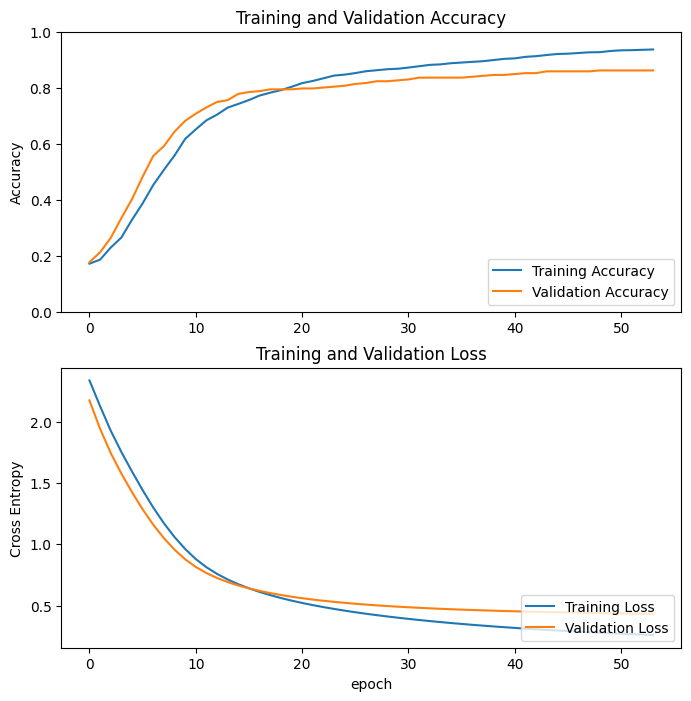

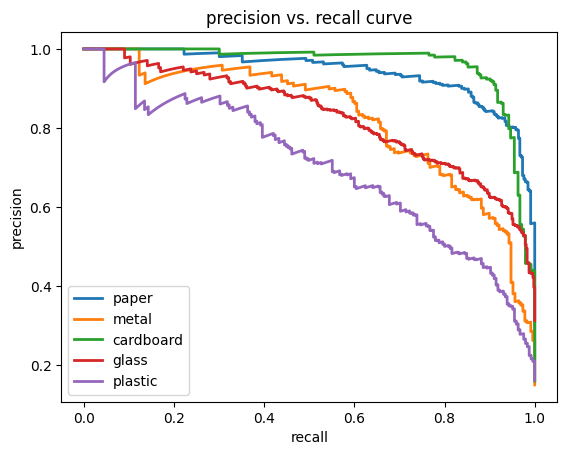

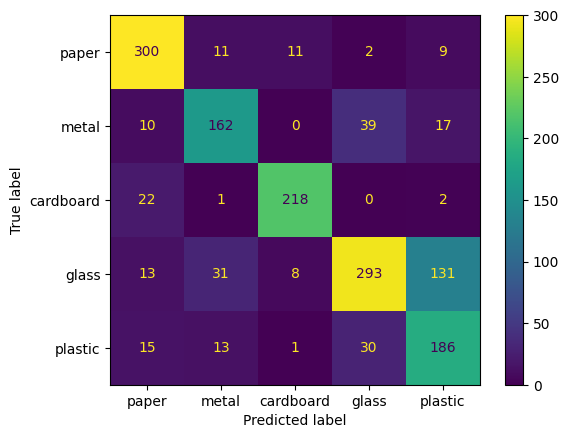

Precision score: 0.77688644411076


In [38]:
if model is None:

    base_model,img_shape = initMobileNet()
    model = addClassifier(base_model,img_shape,NUMLABELS)
    model.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
            metrics=[tf.keras.metrics.CategoricalAccuracy(name='accuracy')])


model.load_weights("checkpoints/baseline_ckpt.h5")

base_eval = model.evaluate(batched_basetest_ds)

print(f"Base test accuracy {base_eval[1]:3f}\n")
y_pred = model.predict(batched_test_ds)

y_pred_indices = np.argmax(y_pred, axis=1)
y_true_indices = np.argmax(y_test, axis=1)

print(classification_report(y_true_indices, y_pred_indices, target_names=CLASSLABELS))

train_acc = history.history['accuracy']
train_loss = history.history['loss']
val_acc = history.history['val_accuracy']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(train_acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([0,1.0])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(train_loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='lower right')
plt.ylabel('Cross Entropy')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

# precision recall curve
precision = dict()
recall = dict()
asap = dict()
for i,label in enumerate(CLASSLABELS):

    precision[label], recall[label], _ = precision_recall_curve(y_test[:,i],
                                                        y_pred[:, i])

    plt.plot(recall[label], precision[label], lw=2, label=label)

plt.xlabel("recall")
plt.ylabel("precision")
plt.legend(loc="best")
plt.title("precision vs. recall curve")
plt.show()

ConfusionMatrixDisplay.from_predictions(y_true_indices, y_pred_indices, display_labels=CLASSLABELS)
plt.show()

p_score = precision_score(y_true_indices, y_pred_indices, average='weighted')
print(f"Precision score: {p_score}")

# Self-Training with Pseudo-labeling

In [ ]:
"""
epochs = [100]
u_weight= [1.0]
threshold = [0.9]
learning_rate = [1e-4]#, 5e-5]

total_steps = (len(train_path) // BATCH_SIZE) * epochs[0]

weight_decay = [5e-5]#[5e-3, 5e-4, 5e-5]

lr_scheduler = tf.keras.optimizers.schedules.CosineDecay(lr/10,
                                            decay_steps=total_steps * 0.9,
                                            alpha=1e-5/lr,
                                            warmup_steps=total_steps * 0.1,
                                            warmup_target=lr)

"""

Search for best hyperparameters

In [125]:
epochs = [100]
u_weight= [1.0]
threshold = [0.9]
learning_rate = [5e-4, 1e-4, 5e-5]

total_steps = (len(train_path) // BATCH_SIZE) * epochs[0]

weight_decay = [5e-3, 5e-4, 5e-5, 5e-6]

hyperparams = itertools.product(epochs, u_weight, threshold, learning_rate, weight_decay)

hist_dict = {}

for epoch, u_weight, threshold, lr, weight_decay in hyperparams:

    base_model,img_shape = initMobileNet()
    model = addClassifier(base_model,img_shape,NUMLABELS)

    train_name = f"u_weight-{u_weight}_threshold-{threshold}_lr-{lr}_weight_decay-{weight_decay}"

    print(train_name+"\n")
    
    trainer = TrainerModel(u_weight, u_ratio, train_name,threshold)

    lr_scheduler = tf.keras.optimizers.schedules.CosineDecay(lr/10,
                                            decay_steps=total_steps * 0.9,
                                            alpha=1e-5/lr,
                                            warmup_steps=total_steps * 0.1,
                                            warmup_target=lr)
    
    optimizer = tf.keras.optimizers.Adam(learning_rate=lr_scheduler, weight_decay=weight_decay, use_ema=True, ema_momentum=0.999)
    
    history = trainer.fit(model, epoch, optimizer, batched_train_ds, batched_val_ds, batched_unlabel_aug_ds)
    hist_dict[epoch, u_weight, threshold, lr, weight_decay] = history

    gc.collect()

f = open("history_dict.pkl", "wb")

pickle.dump(hist_dict,f)

f.close()

u_weight-1.0_threshold-0.9_lr-0.0005_weight_decay-0.005

unlabel over 0.9: 11.0
ckpt_epoch0_val_0.3055_.h5
Epoch: 0 - Train loss[1.9614] - Train acc[0.22] -- Val loss[1.7052] - Val acc[0.31] - lr: 0.0000950
unlabel over 0.9: 27.0
ckpt_epoch1_val_0.4469_.h5
Epoch: 1 - Train loss[1.5881] - Train acc[0.35] -- Val loss[1.3691] - Val acc[0.45] - lr: 0.0001409
unlabel over 0.9: 38.0
ckpt_epoch2_val_0.5788_.h5
Epoch: 2 - Train loss[1.2476] - Train acc[0.49] -- Val loss[1.0858] - Val acc[0.58] - lr: 0.0001867
unlabel over 0.9: 84.0
ckpt_epoch3_val_0.6527_.h5
Epoch: 3 - Train loss[0.9981] - Train acc[0.63] -- Val loss[0.8853] - Val acc[0.65] - lr: 0.0002326
unlabel over 0.9: 143.0
ckpt_epoch4_val_0.7074_.h5
Epoch: 4 - Train loss[0.8306] - Train acc[0.71] -- Val loss[0.7501] - Val acc[0.71] - lr: 0.0002785
unlabel over 0.9: 226.0
ckpt_epoch5_val_0.7653_.h5
Epoch: 5 - Train loss[0.7352] - Train acc[0.74] -- Val loss[0.6600] - Val acc[0.77] - lr: 0.0003243
unlabel over 0.9: 337.0
ckpt_epoch6_val_0

unlabel over 0.9: 16.0
ckpt_epoch0_val_0.3280_.h5
Epoch: 0 - Train loss[1.8248] - Train acc[0.26] -- Val loss[1.5271] - Val acc[0.33] - lr: 0.0000950
unlabel over 0.9: 12.0
ckpt_epoch1_val_0.4727_.h5
Epoch: 1 - Train loss[1.4872] - Train acc[0.37] -- Val loss[1.2419] - Val acc[0.47] - lr: 0.0001409
unlabel over 0.9: 35.0
ckpt_epoch2_val_0.5981_.h5
Epoch: 2 - Train loss[1.1955] - Train acc[0.52] -- Val loss[1.0070] - Val acc[0.60] - lr: 0.0001867
unlabel over 0.9: 85.0
ckpt_epoch3_val_0.6752_.h5
Epoch: 3 - Train loss[0.9804] - Train acc[0.63] -- Val loss[0.8418] - Val acc[0.68] - lr: 0.0002326
unlabel over 0.9: 178.0
ckpt_epoch4_val_0.7010_.h5
Epoch: 4 - Train loss[0.8440] - Train acc[0.69] -- Val loss[0.7315] - Val acc[0.70] - lr: 0.0002785
unlabel over 0.9: 320.0
ckpt_epoch5_val_0.7428_.h5
Epoch: 5 - Train loss[0.7494] - Train acc[0.74] -- Val loss[0.6546] - Val acc[0.74] - lr: 0.0003243
unlabel over 0.9: 450.0
ckpt_epoch6_val_0.7524_.h5
Epoch: 6 - Train loss[0.6818] - Train acc[0.78]

unlabel over 0.9: 13.0
ckpt_epoch0_val_0.2669_.h5
Epoch: 0 - Train loss[2.0190] - Train acc[0.20] -- Val loss[1.6627] - Val acc[0.27] - lr: 0.0000950
unlabel over 0.9: 19.0
ckpt_epoch1_val_0.4437_.h5
Epoch: 1 - Train loss[1.6149] - Train acc[0.33] -- Val loss[1.3122] - Val acc[0.44] - lr: 0.0001409
unlabel over 0.9: 50.0
ckpt_epoch2_val_0.6109_.h5
Epoch: 2 - Train loss[1.2724] - Train acc[0.48] -- Val loss[1.0217] - Val acc[0.61] - lr: 0.0001867
unlabel over 0.9: 126.0
ckpt_epoch3_val_0.7267_.h5
Epoch: 3 - Train loss[1.0239] - Train acc[0.61] -- Val loss[0.8241] - Val acc[0.73] - lr: 0.0002326
unlabel over 0.9: 216.0
ckpt_epoch4_val_0.7781_.h5
Epoch: 4 - Train loss[0.8502] - Train acc[0.69] -- Val loss[0.6980] - Val acc[0.78] - lr: 0.0002785
unlabel over 0.9: 353.0
ckpt_epoch5_val_0.8039_.h5
Epoch: 5 - Train loss[0.7423] - Train acc[0.75] -- Val loss[0.6170] - Val acc[0.80] - lr: 0.0003243
unlabel over 0.9: 476.0
ckpt_epoch6_val_0.8360_.h5
Epoch: 6 - Train loss[0.6730] - Train acc[0.78

u_weight-1.0_threshold-0.9_lr-0.0005_weight_decay-5e-06

unlabel over 0.9: 22.0
ckpt_epoch0_val_0.3087_.h5
Epoch: 0 - Train loss[1.9623] - Train acc[0.23] -- Val loss[1.5989] - Val acc[0.31] - lr: 0.0000950
unlabel over 0.9: 12.0
ckpt_epoch1_val_0.4630_.h5
Epoch: 1 - Train loss[1.5331] - Train acc[0.36] -- Val loss[1.2732] - Val acc[0.46] - lr: 0.0001409
unlabel over 0.9: 26.0
ckpt_epoch2_val_0.6334_.h5
Epoch: 2 - Train loss[1.2069] - Train acc[0.53] -- Val loss[1.0084] - Val acc[0.63] - lr: 0.0001867
unlabel over 0.9: 64.0
ckpt_epoch3_val_0.7010_.h5
Epoch: 3 - Train loss[0.9656] - Train acc[0.63] -- Val loss[0.8262] - Val acc[0.70] - lr: 0.0002326
unlabel over 0.9: 160.0
ckpt_epoch4_val_0.7524_.h5
Epoch: 4 - Train loss[0.8238] - Train acc[0.70] -- Val loss[0.7075] - Val acc[0.75] - lr: 0.0002785
unlabel over 0.9: 256.0
ckpt_epoch5_val_0.7685_.h5
Epoch: 5 - Train loss[0.7183] - Train acc[0.75] -- Val loss[0.6284] - Val acc[0.77] - lr: 0.0003243
unlabel over 0.9: 368.0
ckpt_epoch6_val_0

u_weight-1.0_threshold-0.9_lr-0.0001_weight_decay-0.005

unlabel over 0.9: 36.0
ckpt_epoch0_val_0.2058_.h5
Epoch: 0 - Train loss[2.0437] - Train acc[0.20] -- Val loss[1.9143] - Val acc[0.21] - lr: 0.0000190
unlabel over 0.9: 29.0
ckpt_epoch1_val_0.2379_.h5
Epoch: 1 - Train loss[1.9281] - Train acc[0.22] -- Val loss[1.7856] - Val acc[0.24] - lr: 0.0000282
unlabel over 0.9: 25.0
ckpt_epoch2_val_0.2926_.h5
Epoch: 2 - Train loss[1.7905] - Train acc[0.26] -- Val loss[1.6477] - Val acc[0.29] - lr: 0.0000373
unlabel over 0.9: 24.0
ckpt_epoch3_val_0.3633_.h5
Epoch: 3 - Train loss[1.6427] - Train acc[0.30] -- Val loss[1.5083] - Val acc[0.36] - lr: 0.0000465
unlabel over 0.9: 25.0
ckpt_epoch4_val_0.4244_.h5
Epoch: 4 - Train loss[1.4950] - Train acc[0.37] -- Val loss[1.3722] - Val acc[0.42] - lr: 0.0000557
unlabel over 0.9: 31.0
ckpt_epoch5_val_0.5241_.h5
Epoch: 5 - Train loss[1.3532] - Train acc[0.44] -- Val loss[1.2450] - Val acc[0.52] - lr: 0.0000649
unlabel over 0.9: 47.0
ckpt_epoch6_val_0.55

unlabel over 0.9: 24.0
ckpt_epoch0_val_0.1897_.h5
Epoch: 0 - Train loss[2.1472] - Train acc[0.19] -- Val loss[1.9308] - Val acc[0.19] - lr: 0.0000190
unlabel over 0.9: 14.0
ckpt_epoch1_val_0.2026_.h5
Epoch: 1 - Train loss[2.0039] - Train acc[0.20] -- Val loss[1.7984] - Val acc[0.20] - lr: 0.0000282
unlabel over 0.9: 13.0
ckpt_epoch2_val_0.2637_.h5
Epoch: 2 - Train loss[1.8536] - Train acc[0.24] -- Val loss[1.6664] - Val acc[0.26] - lr: 0.0000373
unlabel over 0.9: 15.0
ckpt_epoch3_val_0.3087_.h5
Epoch: 3 - Train loss[1.7044] - Train acc[0.30] -- Val loss[1.5322] - Val acc[0.31] - lr: 0.0000465
unlabel over 0.9: 21.0
ckpt_epoch4_val_0.3955_.h5
Epoch: 4 - Train loss[1.5558] - Train acc[0.36] -- Val loss[1.3970] - Val acc[0.40] - lr: 0.0000557
unlabel over 0.9: 26.0
ckpt_epoch5_val_0.4469_.h5
Epoch: 5 - Train loss[1.4098] - Train acc[0.42] -- Val loss[1.2680] - Val acc[0.45] - lr: 0.0000649
unlabel over 0.9: 31.0
ckpt_epoch6_val_0.5209_.h5
Epoch: 6 - Train loss[1.2744] - Train acc[0.49] --

unlabel over 0.9: 114.0
ckpt_epoch0_val_0.2540_.h5
Epoch: 0 - Train loss[2.2055] - Train acc[0.25] -- Val loss[2.0417] - Val acc[0.25] - lr: 0.0000190
unlabel over 0.9: 66.0
ckpt_epoch1_val_0.2765_.h5
Epoch: 1 - Train loss[2.0076] - Train acc[0.27] -- Val loss[1.8338] - Val acc[0.28] - lr: 0.0000282
unlabel over 0.9: 39.0
ckpt_epoch2_val_0.3183_.h5
Epoch: 2 - Train loss[1.8137] - Train acc[0.29] -- Val loss[1.6517] - Val acc[0.32] - lr: 0.0000373
unlabel over 0.9: 28.0
ckpt_epoch3_val_0.3794_.h5
Epoch: 3 - Train loss[1.6478] - Train acc[0.33] -- Val loss[1.4979] - Val acc[0.38] - lr: 0.0000465
unlabel over 0.9: 26.0
ckpt_epoch4_val_0.4180_.h5
Epoch: 4 - Train loss[1.4982] - Train acc[0.39] -- Val loss[1.3578] - Val acc[0.42] - lr: 0.0000557
unlabel over 0.9: 29.0
ckpt_epoch5_val_0.4887_.h5
Epoch: 5 - Train loss[1.3587] - Train acc[0.45] -- Val loss[1.2270] - Val acc[0.49] - lr: 0.0000649
unlabel over 0.9: 45.0
ckpt_epoch6_val_0.5627_.h5
Epoch: 6 - Train loss[1.2316] - Train acc[0.51] -

unlabel over 0.9: 19.0
ckpt_epoch0_val_0.2283_.h5
Epoch: 0 - Train loss[2.0011] - Train acc[0.23] -- Val loss[1.8561] - Val acc[0.23] - lr: 0.0000190
unlabel over 0.9: 13.0
ckpt_epoch1_val_0.2733_.h5
Epoch: 1 - Train loss[1.8681] - Train acc[0.26] -- Val loss[1.7230] - Val acc[0.27] - lr: 0.0000282
unlabel over 0.9: 12.0
ckpt_epoch2_val_0.3344_.h5
Epoch: 2 - Train loss[1.7308] - Train acc[0.30] -- Val loss[1.5946] - Val acc[0.33] - lr: 0.0000373
unlabel over 0.9: 15.0
ckpt_epoch3_val_0.3794_.h5
Epoch: 3 - Train loss[1.5967] - Train acc[0.36] -- Val loss[1.4677] - Val acc[0.38] - lr: 0.0000465
unlabel over 0.9: 23.0
ckpt_epoch4_val_0.4502_.h5
Epoch: 4 - Train loss[1.4637] - Train acc[0.41] -- Val loss[1.3430] - Val acc[0.45] - lr: 0.0000557
unlabel over 0.9: 28.0
ckpt_epoch5_val_0.5209_.h5
Epoch: 5 - Train loss[1.3335] - Train acc[0.46] -- Val loss[1.2261] - Val acc[0.52] - lr: 0.0000649
unlabel over 0.9: 40.0
ckpt_epoch6_val_0.5691_.h5
Epoch: 6 - Train loss[1.2139] - Train acc[0.52] --

unlabel over 0.9: 9.0
ckpt_epoch0_val_0.1286_.h5
Epoch: 0 - Train loss[2.2008] - Train acc[0.15] -- Val loss[2.1377] - Val acc[0.13] - lr: 0.0000095
unlabel over 0.9: 9.0
ckpt_epoch1_val_0.1318_.h5
Epoch: 1 - Train loss[2.1321] - Train acc[0.17] -- Val loss[2.0518] - Val acc[0.13] - lr: 0.0000141
unlabel over 0.9: 10.0
ckpt_epoch2_val_0.1543_.h5
Epoch: 2 - Train loss[2.0470] - Train acc[0.18] -- Val loss[1.9516] - Val acc[0.15] - lr: 0.0000187
unlabel over 0.9: 8.0
ckpt_epoch3_val_0.1929_.h5
Epoch: 3 - Train loss[1.9469] - Train acc[0.20] -- Val loss[1.8443] - Val acc[0.19] - lr: 0.0000233
unlabel over 0.9: 10.0
ckpt_epoch4_val_0.2186_.h5
Epoch: 4 - Train loss[1.8411] - Train acc[0.24] -- Val loss[1.7334] - Val acc[0.22] - lr: 0.0000278
unlabel over 0.9: 13.0
ckpt_epoch5_val_0.2733_.h5
Epoch: 5 - Train loss[1.7294] - Train acc[0.29] -- Val loss[1.6206] - Val acc[0.27] - lr: 0.0000324
unlabel over 0.9: 14.0
ckpt_epoch6_val_0.3505_.h5
Epoch: 6 - Train loss[1.6141] - Train acc[0.32] -- Va

unlabel over 0.9: 20.0
ckpt_epoch0_val_0.2186_.h5
Epoch: 0 - Train loss[2.0973] - Train acc[0.20] -- Val loss[1.9374] - Val acc[0.22] - lr: 0.0000095
unlabel over 0.9: 16.0
ckpt_epoch1_val_0.2251_.h5
Epoch: 1 - Train loss[2.0392] - Train acc[0.21] -- Val loss[1.8694] - Val acc[0.23] - lr: 0.0000141
unlabel over 0.9: 18.0
ckpt_epoch2_val_0.2540_.h5
Epoch: 2 - Train loss[1.9627] - Train acc[0.22] -- Val loss[1.7877] - Val acc[0.25] - lr: 0.0000187
unlabel over 0.9: 16.0
ckpt_epoch3_val_0.2926_.h5
Epoch: 3 - Train loss[1.8716] - Train acc[0.25] -- Val loss[1.6975] - Val acc[0.29] - lr: 0.0000233
unlabel over 0.9: 14.0
ckpt_epoch4_val_0.3312_.h5
Epoch: 4 - Train loss[1.7705] - Train acc[0.28] -- Val loss[1.6022] - Val acc[0.33] - lr: 0.0000278
unlabel over 0.9: 14.0
ckpt_epoch5_val_0.3569_.h5
Epoch: 5 - Train loss[1.6652] - Train acc[0.32] -- Val loss[1.5045] - Val acc[0.36] - lr: 0.0000324
unlabel over 0.9: 12.0
ckpt_epoch6_val_0.3859_.h5
Epoch: 6 - Train loss[1.5574] - Train acc[0.36] --

unlabel over 0.9: 32.0
ckpt_epoch0_val_0.2508_.h5
Epoch: 0 - Train loss[1.9795] - Train acc[0.24] -- Val loss[1.8169] - Val acc[0.25] - lr: 0.0000095
unlabel over 0.9: 27.0
ckpt_epoch1_val_0.2765_.h5
Epoch: 1 - Train loss[1.9217] - Train acc[0.25] -- Val loss[1.7541] - Val acc[0.28] - lr: 0.0000141
unlabel over 0.9: 22.0
ckpt_epoch2_val_0.2894_.h5
Epoch: 2 - Train loss[1.8504] - Train acc[0.27] -- Val loss[1.6825] - Val acc[0.29] - lr: 0.0000187
unlabel over 0.9: 17.0
ckpt_epoch3_val_0.3151_.h5
Epoch: 3 - Train loss[1.7709] - Train acc[0.30] -- Val loss[1.6062] - Val acc[0.32] - lr: 0.0000233
unlabel over 0.9: 19.0
ckpt_epoch4_val_0.3408_.h5
Epoch: 4 - Train loss[1.6870] - Train acc[0.32] -- Val loss[1.5270] - Val acc[0.34] - lr: 0.0000278
unlabel over 0.9: 18.0
ckpt_epoch5_val_0.3859_.h5
Epoch: 5 - Train loss[1.5970] - Train acc[0.35] -- Val loss[1.4459] - Val acc[0.39] - lr: 0.0000324
unlabel over 0.9: 19.0
ckpt_epoch6_val_0.4180_.h5
Epoch: 6 - Train loss[1.5036] - Train acc[0.39] --

unlabel over 0.9: 27.0
ckpt_epoch0_val_0.1865_.h5
Epoch: 0 - Train loss[2.0882] - Train acc[0.22] -- Val loss[1.9905] - Val acc[0.19] - lr: 0.0000095
unlabel over 0.9: 20.0
ckpt_epoch1_val_0.2122_.h5
Epoch: 1 - Train loss[2.0028] - Train acc[0.23] -- Val loss[1.8964] - Val acc[0.21] - lr: 0.0000141
unlabel over 0.9: 15.0
ckpt_epoch2_val_0.2637_.h5
Epoch: 2 - Train loss[1.8961] - Train acc[0.25] -- Val loss[1.7936] - Val acc[0.26] - lr: 0.0000187
unlabel over 0.9: 14.0
ckpt_epoch3_val_0.3119_.h5
Epoch: 3 - Train loss[1.7858] - Train acc[0.28] -- Val loss[1.6952] - Val acc[0.31] - lr: 0.0000233
unlabel over 0.9: 16.0
ckpt_epoch4_val_0.3569_.h5
Epoch: 4 - Train loss[1.6817] - Train acc[0.31] -- Val loss[1.6035] - Val acc[0.36] - lr: 0.0000278
unlabel over 0.9: 24.0
ckpt_epoch5_val_0.3923_.h5
Epoch: 5 - Train loss[1.5849] - Train acc[0.35] -- Val loss[1.5140] - Val acc[0.39] - lr: 0.0000324
unlabel over 0.9: 28.0
ckpt_epoch6_val_0.4180_.h5
Epoch: 6 - Train loss[1.4875] - Train acc[0.40] --

In [46]:
import pandas as pd

best_params = None

best_val = 0.
best_epoch = 0

f = open("history_dict.pkl", "rb")

hist_dict = pickle.load(f)

f.close()

learning_rate = [5e-4, 1e-4, 5e-5]

weight_decay = [5e-3, 5e-4, 5e-5, 5e-6]

matrix_acc = np.zeros((len(learning_rate), len(weight_decay)))

for i,lr in enumerate(learning_rate):
    for j,wd in enumerate(weight_decay):

        acc = np.max(hist_dict[(100,1.0,0.9,lr,wd)]['val_acc_values'])

        matrix_acc[i][j] = acc
        
        if acc > best_val:

            best_val = acc
            best_epoch = np.argmax(hist_dict[(100,1.0,0.9,lr,wd)]['val_acc_values'])
            best_params = (100,1.0,0.9,lr,wd)

learning_rate = ['lr 5e-4', 'lr 1e-4', 'lr 5e-5']

weight_decay = ['w decay 5e-3', 'w decay 5e-4', 'w decay 5e-5', 'w decay 5e-6']
df = pd.DataFrame(matrix_acc, index=learning_rate, columns=weight_decay)
print()
# Display the DataFrame
print(df)
print()
print(f"best params - learning_rate: {best_params[3]}, weight_decay: {best_params[4]}")
print(f"best validation accuracy: {best_val: 0.3f} at epoch {best_epoch+1}")

print(f"train accuracy at epoch {best_epoch+1}: {hist_dict[best_params]['train_acc_values'][best_epoch]: 0.3f}")


         w decay 5e-3  w decay 5e-4  w decay 5e-5  w decay 5e-6
lr 5e-4      0.826367      0.842444      0.852090      0.845659
lr 1e-4      0.836013      0.836013      0.832797      0.858521
lr 5e-5      0.794212      0.813505      0.816720      0.784566

best params - learning_rate: 0.0001, weight_decay: 5e-06
best validation accuracy:  0.859 at epoch 34
train accuracy at epoch 34:  0.846


**Train with different Threshold**

In [ ]:
epochs = [100]
u_weight= [1.0]
threshold = [0.8, 0.825, 0.85, 0.875, 0.925, 0.95, 0.96, 0.97, 0.98, 0.99]
learning_rate = [1e-4]

total_steps = (len(train_path) // BATCH_SIZE) * epochs[0]

weight_decay = [5e-6]

hyperparams = itertools.product(epochs, u_weight, threshold, learning_rate, weight_decay)

threshold_dict = {}

for epoch, u_weight, threshold, lr, weight_decay in hyperparams:

    base_model,img_shape = initMobileNet()
    model = addClassifier(base_model,img_shape,NUMLABELS)

    train_name = f"u_weight-{u_weight}_threshold-{threshold}_lr-{lr}_weight_decay-{weight_decay}"

    print(train_name+"\n")
    
    trainer = TrainerModel(u_weight, u_ratio, train_name,threshold)

    lr_scheduler = tf.keras.optimizers.schedules.CosineDecay(lr/10,
                                            decay_steps=total_steps * 0.9,
                                            alpha=1e-5/lr,
                                            warmup_steps=total_steps * 0.1,
                                            warmup_target=lr)
    
    optimizer = tf.keras.optimizers.Adam(learning_rate=lr_scheduler, weight_decay=weight_decay, use_ema=True, ema_momentum=0.999)#, use_ema=True) #da aggiungere weight_decay probabilmente
    
    history = trainer.fit(model, epoch, optimizer, batched_train_ds, batched_val_ds, batched_unlabel_aug_ds)
    threshold_dict[epoch, u_weight, threshold, lr, weight_decay] = history

    gc.collect()

f = open("threshold_dict.pkl", "wb")

pickle.dump(threshold_dict,f)

f.close()

u_weight-1.0_threshold-0.8_lr-0.0001_weight_decay-5e-06



unlabel over 0.8: 236.0
ckpt_epoch0_val_0.2444_.h5
Epoch: 0 - Train loss[2.4242] - Train acc[0.25] -- Val loss[2.0169] - Val acc[0.24] - lr: 0.0000190
unlabel over 0.8: 176.0
ckpt_epoch1_val_0.2508_.h5
Epoch: 1 - Train loss[2.2096] - Train acc[0.26] -- Val loss[1.8405] - Val acc[0.25] - lr: 0.0000282
unlabel over 0.8: 126.0
ckpt_epoch2_val_0.2701_.h5
Epoch: 2 - Train loss[2.0009] - Train acc[0.28] -- Val loss[1.6871] - Val acc[0.27] - lr: 0.0000373
unlabel over 0.8: 112.0
ckpt_epoch3_val_0.3215_.h5
Epoch: 3 - Train loss[1.8228] - Train acc[0.31] -- Val loss[1.5483] - Val acc[0.32] - lr: 0.0000465
unlabel over 0.8: 115.0
ckpt_epoch4_val_0.4019_.h5
Epoch: 4 - Train loss[1.6597] - Train acc[0.36] -- Val loss[1.4076] - Val acc[0.40] - lr: 0.0000557
unlabel over 0.8: 125.0
ckpt_epoch5_val_0.4695_.h5
Epoch: 5 - Train loss[1.5042] - Train acc[0.42] -- Val loss[1.2694] - Val acc[0.47] - lr: 0.0000649
unlabel over 0.8: 152.0
ckpt_epoch6_val_0.5402_.h5
Epoch: 6 - Train loss[1.3621] - Train acc[0

unlabel over 0.825: 139.0
ckpt_epoch0_val_0.2508_.h5
Epoch: 0 - Train loss[2.0035] - Train acc[0.28] -- Val loss[1.7589] - Val acc[0.25] - lr: 0.0000190
unlabel over 0.825: 102.0
ckpt_epoch1_val_0.2797_.h5
Epoch: 1 - Train loss[1.8459] - Train acc[0.30] -- Val loss[1.6247] - Val acc[0.28] - lr: 0.0000282
unlabel over 0.825: 104.0
ckpt_epoch2_val_0.3248_.h5
Epoch: 2 - Train loss[1.7100] - Train acc[0.33] -- Val loss[1.5074] - Val acc[0.32] - lr: 0.0000373
unlabel over 0.825: 115.0
ckpt_epoch3_val_0.3730_.h5
Epoch: 3 - Train loss[1.5868] - Train acc[0.37] -- Val loss[1.3954] - Val acc[0.37] - lr: 0.0000465
unlabel over 0.825: 136.0
ckpt_epoch4_val_0.4469_.h5
Epoch: 4 - Train loss[1.4678] - Train acc[0.42] -- Val loss[1.2833] - Val acc[0.45] - lr: 0.0000557
unlabel over 0.825: 175.0
ckpt_epoch5_val_0.5113_.h5
Epoch: 5 - Train loss[1.3569] - Train acc[0.47] -- Val loss[1.1750] - Val acc[0.51] - lr: 0.0000649
unlabel over 0.825: 223.0
ckpt_epoch6_val_0.5691_.h5
Epoch: 6 - Train loss[1.2532]

unlabel over 0.85: 90.0
ckpt_epoch0_val_0.2026_.h5
Epoch: 0 - Train loss[2.1748] - Train acc[0.22] -- Val loss[1.9843] - Val acc[0.20] - lr: 0.0000190
unlabel over 0.85: 87.0
ckpt_epoch1_val_0.2315_.h5
Epoch: 1 - Train loss[2.0111] - Train acc[0.25] -- Val loss[1.8141] - Val acc[0.23] - lr: 0.0000282
unlabel over 0.85: 82.0
ckpt_epoch2_val_0.2926_.h5
Epoch: 2 - Train loss[1.8371] - Train acc[0.29] -- Val loss[1.6583] - Val acc[0.29] - lr: 0.0000373
unlabel over 0.85: 76.0
ckpt_epoch3_val_0.3537_.h5
Epoch: 3 - Train loss[1.6772] - Train acc[0.33] -- Val loss[1.5223] - Val acc[0.35] - lr: 0.0000465
unlabel over 0.85: 86.0
ckpt_epoch4_val_0.4180_.h5
Epoch: 4 - Train loss[1.5384] - Train acc[0.38] -- Val loss[1.3940] - Val acc[0.42] - lr: 0.0000557
unlabel over 0.85: 102.0
ckpt_epoch5_val_0.5048_.h5
Epoch: 5 - Train loss[1.4072] - Train acc[0.44] -- Val loss[1.2708] - Val acc[0.50] - lr: 0.0000649
unlabel over 0.85: 128.0
ckpt_epoch6_val_0.5370_.h5
Epoch: 6 - Train loss[1.2877] - Train acc

unlabel over 0.875: 55.0
ckpt_epoch0_val_0.1640_.h5
Epoch: 0 - Train loss[2.2432] - Train acc[0.19] -- Val loss[2.0924] - Val acc[0.16] - lr: 0.0000190
unlabel over 0.875: 42.0
ckpt_epoch1_val_0.1801_.h5
Epoch: 1 - Train loss[2.1136] - Train acc[0.21] -- Val loss[1.9340] - Val acc[0.18] - lr: 0.0000282
unlabel over 0.875: 30.0
ckpt_epoch2_val_0.2154_.h5
Epoch: 2 - Train loss[1.9627] - Train acc[0.23] -- Val loss[1.7710] - Val acc[0.22] - lr: 0.0000373
unlabel over 0.875: 27.0
ckpt_epoch3_val_0.2797_.h5
Epoch: 3 - Train loss[1.8066] - Train acc[0.28] -- Val loss[1.6080] - Val acc[0.28] - lr: 0.0000465
unlabel over 0.875: 29.0
ckpt_epoch4_val_0.3633_.h5
Epoch: 4 - Train loss[1.6453] - Train acc[0.33] -- Val loss[1.4487] - Val acc[0.36] - lr: 0.0000557
unlabel over 0.875: 31.0
ckpt_epoch5_val_0.4566_.h5
Epoch: 5 - Train loss[1.4878] - Train acc[0.40] -- Val loss[1.2996] - Val acc[0.46] - lr: 0.0000649
unlabel over 0.875: 45.0
ckpt_epoch6_val_0.5563_.h5
Epoch: 6 - Train loss[1.3429] - Trai

unlabel over 0.925: 15.0
ckpt_epoch0_val_0.1704_.h5
Epoch: 0 - Train loss[2.2167] - Train acc[0.19] -- Val loss[2.1200] - Val acc[0.17] - lr: 0.0000190
unlabel over 0.925: 9.0
ckpt_epoch1_val_0.2026_.h5
Epoch: 1 - Train loss[2.0762] - Train acc[0.21] -- Val loss[1.9536] - Val acc[0.20] - lr: 0.0000282
unlabel over 0.925: 5.0
ckpt_epoch2_val_0.2412_.h5
Epoch: 2 - Train loss[1.9147] - Train acc[0.25] -- Val loss[1.7833] - Val acc[0.24] - lr: 0.0000373
unlabel over 0.925: 4.0
ckpt_epoch3_val_0.3151_.h5
Epoch: 3 - Train loss[1.7521] - Train acc[0.29] -- Val loss[1.6224] - Val acc[0.32] - lr: 0.0000465
unlabel over 0.925: 4.0
ckpt_epoch4_val_0.3730_.h5
Epoch: 4 - Train loss[1.5921] - Train acc[0.34] -- Val loss[1.4701] - Val acc[0.37] - lr: 0.0000557
unlabel over 0.925: 3.0
ckpt_epoch5_val_0.4469_.h5
Epoch: 5 - Train loss[1.4363] - Train acc[0.40] -- Val loss[1.3282] - Val acc[0.45] - lr: 0.0000649
unlabel over 0.925: 9.0
ckpt_epoch6_val_0.4952_.h5
Epoch: 6 - Train loss[1.2921] - Train acc[

unlabel over 0.95: 3.0
ckpt_epoch0_val_0.2122_.h5
Epoch: 0 - Train loss[2.1975] - Train acc[0.21] -- Val loss[1.9966] - Val acc[0.21] - lr: 0.0000190
unlabel over 0.95: 3.0
ckpt_epoch1_val_0.2347_.h5
Epoch: 1 - Train loss[2.0578] - Train acc[0.23] -- Val loss[1.8579] - Val acc[0.23] - lr: 0.0000282
unlabel over 0.95: 2.0
ckpt_epoch2_val_0.2637_.h5
Epoch: 2 - Train loss[1.9043] - Train acc[0.26] -- Val loss[1.7203] - Val acc[0.26] - lr: 0.0000373
unlabel over 0.95: 1.0
ckpt_epoch3_val_0.3408_.h5
Epoch: 3 - Train loss[1.7489] - Train acc[0.30] -- Val loss[1.5846] - Val acc[0.34] - lr: 0.0000465
unlabel over 0.95: 2.0
ckpt_epoch4_val_0.3923_.h5
Epoch: 4 - Train loss[1.5961] - Train acc[0.35] -- Val loss[1.4491] - Val acc[0.39] - lr: 0.0000557
unlabel over 0.95: 5.0
ckpt_epoch5_val_0.4534_.h5
Epoch: 5 - Train loss[1.4460] - Train acc[0.41] -- Val loss[1.3191] - Val acc[0.45] - lr: 0.0000649
unlabel over 0.95: 10.0
ckpt_epoch6_val_0.5241_.h5
Epoch: 6 - Train loss[1.3058] - Train acc[0.47] -

unlabel over 0.96: 1.0
ckpt_epoch0_val_0.2958_.h5
Epoch: 0 - Train loss[1.9281] - Train acc[0.23] -- Val loss[1.6317] - Val acc[0.30] - lr: 0.0000190
unlabel over 0.96: 1.0
ckpt_epoch1_val_0.3183_.h5
Epoch: 1 - Train loss[1.8274] - Train acc[0.25] -- Val loss[1.5371] - Val acc[0.32] - lr: 0.0000282
unlabel over 0.96: 2.0
ckpt_epoch2_val_0.3762_.h5
Epoch: 2 - Train loss[1.7043] - Train acc[0.29] -- Val loss[1.4293] - Val acc[0.38] - lr: 0.0000373
unlabel over 0.96: 2.0
ckpt_epoch3_val_0.4791_.h5
Epoch: 3 - Train loss[1.5689] - Train acc[0.34] -- Val loss[1.3121] - Val acc[0.48] - lr: 0.0000465
unlabel over 0.96: 4.0
ckpt_epoch4_val_0.5531_.h5
Epoch: 4 - Train loss[1.4291] - Train acc[0.40] -- Val loss[1.1937] - Val acc[0.55] - lr: 0.0000557
unlabel over 0.96: 5.0
ckpt_epoch5_val_0.6109_.h5
Epoch: 5 - Train loss[1.2933] - Train acc[0.46] -- Val loss[1.0828] - Val acc[0.61] - lr: 0.0000649
unlabel over 0.96: 7.0
ckpt_epoch6_val_0.6527_.h5
Epoch: 6 - Train loss[1.1679] - Train acc[0.54] --

unlabel over 0.97: 5.0
ckpt_epoch0_val_0.2347_.h5
Epoch: 0 - Train loss[2.2592] - Train acc[0.22] -- Val loss[2.0743] - Val acc[0.23] - lr: 0.0000190
unlabel over 0.97: 2.0
Epoch: 1 - Train loss[2.0645] - Train acc[0.23] -- Val loss[1.8779] - Val acc[0.23] - lr: 0.0000282
unlabel over 0.97: 1.0
ckpt_epoch2_val_0.2765_.h5
Epoch: 2 - Train loss[1.8815] - Train acc[0.26] -- Val loss[1.7119] - Val acc[0.28] - lr: 0.0000373
unlabel over 0.97: 7.0
ckpt_epoch3_val_0.3505_.h5
Epoch: 3 - Train loss[1.7208] - Train acc[0.30] -- Val loss[1.5640] - Val acc[0.35] - lr: 0.0000465
unlabel over 0.97: 9.0
ckpt_epoch4_val_0.4244_.h5
Epoch: 4 - Train loss[1.5663] - Train acc[0.36] -- Val loss[1.4228] - Val acc[0.42] - lr: 0.0000557
unlabel over 0.97: 10.0
ckpt_epoch5_val_0.4952_.h5
Epoch: 5 - Train loss[1.4180] - Train acc[0.43] -- Val loss[1.2899] - Val acc[0.50] - lr: 0.0000649
unlabel over 0.97: 9.0
ckpt_epoch6_val_0.5305_.h5
Epoch: 6 - Train loss[1.2787] - Train acc[0.49] -- Val loss[1.1694] - Val ac

unlabel over 0.98: 0.0
ckpt_epoch0_val_0.2958_.h5
Epoch: 0 - Train loss[2.0957] - Train acc[0.23] -- Val loss[1.8505] - Val acc[0.30] - lr: 0.0000190
unlabel over 0.98: 0.0
ckpt_epoch1_val_0.3344_.h5
Epoch: 1 - Train loss[1.9542] - Train acc[0.26] -- Val loss[1.6885] - Val acc[0.33] - lr: 0.0000282
unlabel over 0.98: 0.0
ckpt_epoch2_val_0.4051_.h5
Epoch: 2 - Train loss[1.7979] - Train acc[0.29] -- Val loss[1.5331] - Val acc[0.41] - lr: 0.0000373
unlabel over 0.98: 0.0
ckpt_epoch3_val_0.4598_.h5
Epoch: 3 - Train loss[1.6478] - Train acc[0.33] -- Val loss[1.3957] - Val acc[0.46] - lr: 0.0000465
unlabel over 0.98: 0.0
ckpt_epoch4_val_0.5209_.h5
Epoch: 4 - Train loss[1.5043] - Train acc[0.40] -- Val loss[1.2700] - Val acc[0.52] - lr: 0.0000557
unlabel over 0.98: 0.0
ckpt_epoch5_val_0.5691_.h5
Epoch: 5 - Train loss[1.3650] - Train acc[0.47] -- Val loss[1.1536] - Val acc[0.57] - lr: 0.0000649
unlabel over 0.98: 0.0
ckpt_epoch6_val_0.6270_.h5
Epoch: 6 - Train loss[1.2339] - Train acc[0.52] --

unlabel over 0.99: 0.0
ckpt_epoch0_val_0.1833_.h5
Epoch: 0 - Train loss[2.1289] - Train acc[0.17] -- Val loss[1.9226] - Val acc[0.18] - lr: 0.0000190
unlabel over 0.99: 0.0
ckpt_epoch1_val_0.2444_.h5
Epoch: 1 - Train loss[1.9686] - Train acc[0.20] -- Val loss[1.7635] - Val acc[0.24] - lr: 0.0000282
unlabel over 0.99: 0.0
ckpt_epoch2_val_0.3023_.h5
Epoch: 2 - Train loss[1.8130] - Train acc[0.25] -- Val loss[1.6193] - Val acc[0.30] - lr: 0.0000373
unlabel over 0.99: 0.0
ckpt_epoch3_val_0.3698_.h5
Epoch: 3 - Train loss[1.6623] - Train acc[0.31] -- Val loss[1.4816] - Val acc[0.37] - lr: 0.0000465
unlabel over 0.99: 0.0
ckpt_epoch4_val_0.3955_.h5
Epoch: 4 - Train loss[1.5113] - Train acc[0.36] -- Val loss[1.3454] - Val acc[0.40] - lr: 0.0000557
unlabel over 0.99: 0.0
ckpt_epoch5_val_0.4534_.h5
Epoch: 5 - Train loss[1.3629] - Train acc[0.42] -- Val loss[1.2152] - Val acc[0.45] - lr: 0.0000649
unlabel over 0.99: 0.0
ckpt_epoch6_val_0.5113_.h5
Epoch: 6 - Train loss[1.2240] - Train acc[0.50] --

**Performance Comparison at different Threshold**

In [8]:
threshold = [0.8, 0.825, 0.85, 0.875, 0.925, 0.9, 0.95, 0.96, 0.97, 0.98, 0.99]

f = open("threshold_dict.pkl","rb")

threshold_dict = pickle.load(f)

f.close()

best_metrics = {}

best_threshold = 0.0
best_val = 0.0

for keys in threshold_dict:

    val = np.max(threshold_dict[keys]['val_acc_values'])
    epoch =  np.argmax(threshold_dict[keys]['val_acc_values'])
    train = threshold_dict[keys]['train_acc_values'][epoch]

    if val > best_val:
        best_val = val
        best_threshold = keys[2]
    ckpt =  f"checkpoints/" \
            f"checkpoints_u_weight-1.0_threshold-{keys[2]}_lr-0.0001_weight_decay-5e-06/" \
            f"ckpt_epoch{epoch}_val_{val:0.4f}_.h5"
    best_metrics[keys[2]] = {
        'best_val_accuracy': val,
        'best_epoch': epoch,
        'train_val_at_best_epoch': train,
        'best_ckpt': ckpt 
    }

2024-02-07 18:42:38.793439: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


48/48 [==============================] - 2s 31ms/step


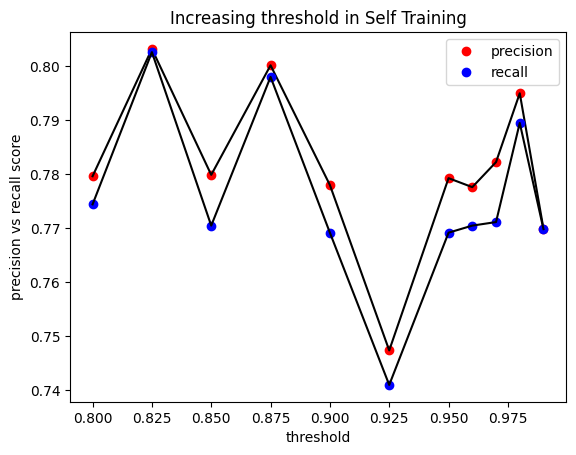

best threshold: 0.825 with precision score: 0.8032185988596796


In [27]:
threshold_pred_dict = {}

base_model,img_shape = initMobileNet()
model = addClassifier(base_model,img_shape,NUMLABELS)

y_true_indices = np.argmax(y_test, axis=1)

best_threshold = 0.
best_p = 0.
for threshold in best_metrics.keys():

    ckpt_path = best_metrics[threshold]['best_ckpt']

    model.load_weights(ckpt_path)
    model.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
            metrics=[tf.keras.metrics.CategoricalAccuracy(name='accuracy')])
    
    y_pred = model.predict(batched_test_ds)
    y_pred_indices = np.argmax(y_pred, axis=1)

    p_score = precision_score(y_true_indices, y_pred_indices, average='weighted')
    r_score = recall_score(y_true_indices, y_pred_indices, average='weighted')
    threshold_pred_dict[threshold] = [p_score, r_score]

    if p_score >= best_p:
        best_p = p_score
        best_threshold = threshold

plt.plot(threshold_pred_dict.keys(),np.array(list(threshold_pred_dict.values()))[:,0], 'ro', label='precision')
plt.plot(threshold_pred_dict.keys(),np.array(list(threshold_pred_dict.values()))[:,0], 'k')

plt.plot(threshold_pred_dict.keys(),np.array(list(threshold_pred_dict.values()))[:,1], 'bo', label='recall')
plt.plot(threshold_pred_dict.keys(),np.array(list(threshold_pred_dict.values()))[:,1], 'k')

plt.ylabel('precision vs recall score')
plt.xlabel('threshold')
plt.title('Increasing threshold in Self Training')
plt.legend()
plt.show()

print(f"best threshold: {best_threshold} with precision score: {best_p}")

Unfortunately this plot is not very informative because has large fluctuations and doesn't show a pattern while increasing the threshold. We expected a growth of precision score together with the threshold, on the other hand we can see a little decreasing of recall values as normally expected.

A possible explanation of this behaviour is the trade-off between the number of pseudo labelled image considered and the precision of predictions at different thresholds. Of course the lower the threshold the more pseudo labelled images are taken. We suppose that in this case, without a large unlabeled dataset, the difference in precision score is very low, so at the end having more images to train with is better for the model performance on learn useful features.

In [28]:
model.load_weights(best_metrics[best_threshold]['best_ckpt'])
model.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
            metrics=[tf.keras.metrics.CategoricalAccuracy(name='accuracy')])

13/13 [==============================] - 0s 30ms/step - loss: 0.4933 - accuracy: 0.8010
Base Test accuracy: 0.800983

48/48 [==============================] - 1s 29ms/step


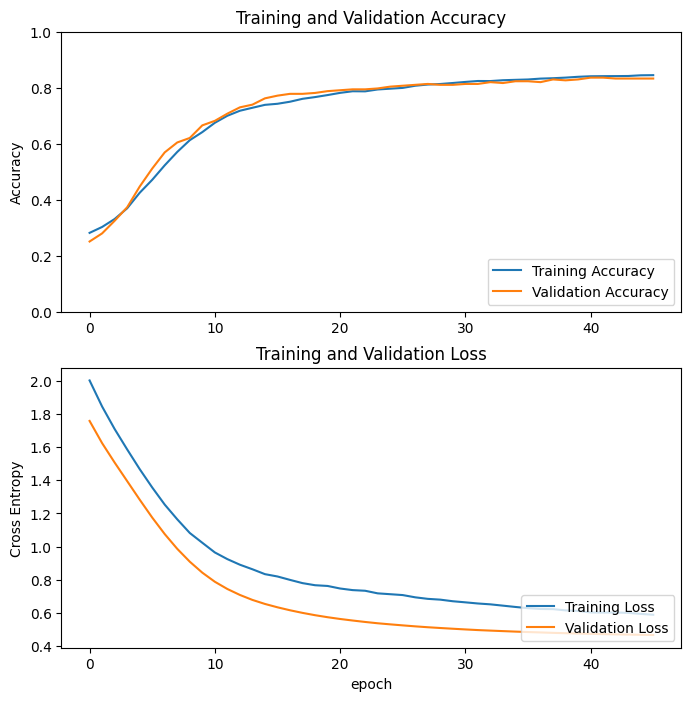

              precision    recall  f1-score   support

       paper       0.81      0.93      0.87       333
       metal       0.75      0.75      0.75       228
   cardboard       0.92      0.85      0.88       243
       glass       0.82      0.78      0.80       476
     plastic       0.70      0.67      0.69       245

    accuracy                           0.80      1525
   macro avg       0.80      0.80      0.80      1525
weighted avg       0.80      0.80      0.80      1525



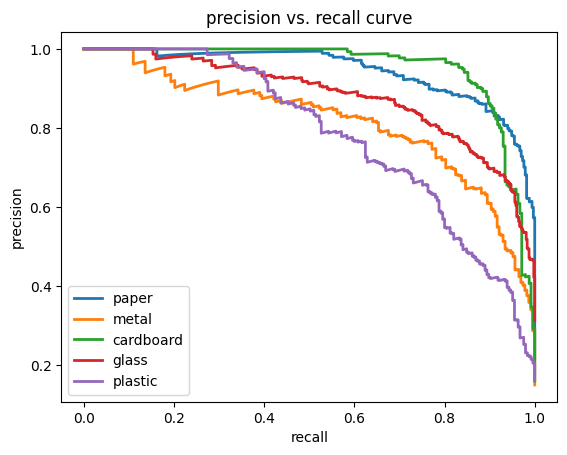

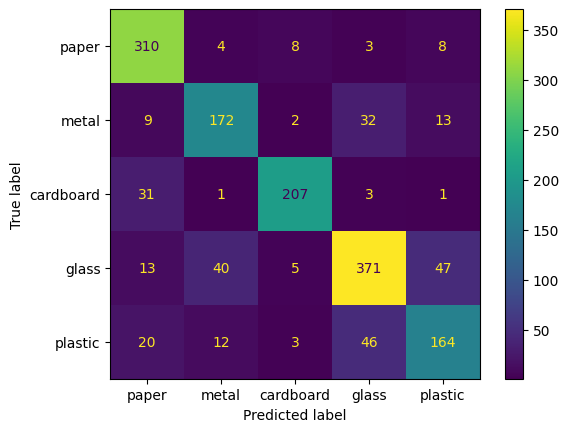

In [44]:
base_eval = model.evaluate(batched_basetest_ds)

print(f"Base Test accuracy: {base_eval[1]:3f}\n")

y_pred = model.predict(batched_test_ds)

y_pred_indices = np.argmax(y_pred, axis=1)
y_true_indices = np.argmax(y_test, axis=1)

train_acc = threshold_dict[(100,1.0,best_threshold,0.0001,5e-06)]['train_acc_values']
train_loss = threshold_dict[(100,1.0,best_threshold,0.0001,5e-06)]['train_loss']
val_acc = threshold_dict[(100,1.0,best_threshold,0.0001,5e-06)]['val_acc_values']
val_loss = threshold_dict[(100,1.0,best_threshold,0.0001,5e-06)]['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(train_acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([0,1.0])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(train_loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='lower right')
plt.ylabel('Cross Entropy')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

print(classification_report(y_true_indices, y_pred_indices, target_names=CLASSLABELS))

# precision recall curve
precision = dict()
recall = dict()
asap = dict()
for i,label in enumerate(CLASSLABELS):

    precision[label], recall[label], _ = precision_recall_curve(y_test[:, i],
                                                        y_pred[:, i])

    plt.plot(recall[label], precision[label], lw=2, label=label)

plt.xlabel("recall")
plt.ylabel("precision")
plt.legend(loc="best")
plt.title("precision vs. recall curve")
plt.show()

ConfusionMatrixDisplay.from_predictions(y_true_indices, y_pred_indices, display_labels=CLASSLABELS)
plt.show()

# GradCam HeatMap

Simple investigation of which part of the image impact most the classification

In [82]:
test_img_path = "plastic_bottle.jpg"
img = load_images_dataset(test_img_path, IMG_SIZE)
img = np.expand_dims(img, axis=0)

pred = model(img, training=False)

pred_label = onehot_dict[np.argmax(pred)]

print(f"material predicted: {pred_label}")

material predicted: plastic


In [47]:
def make_gradcam_heatmap(img_array, model, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions

    last_conv_layer = model.layers[-4].layers[-1]
    last_conv_layer_model = keras.Model(model.layers[-4].inputs, last_conv_layer.output)
    grad_model = last_conv_layer_model

    classifier_input = keras.Input(shape=last_conv_layer.output.shape[1:])
    x = classifier_input
    for layer in model.layers[-3:]:
      x = layer(x)
    classifier_model = keras.Model(classifier_input, x)

    preprocess_layers = keras.Model(model.inputs, model.layers[-5].output)
    img_array_preprocessed = preprocess_layers(img_array)

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output = grad_model(img_array_preprocessed)
        tape.watch(last_conv_layer_output)

        preds = classifier_model(last_conv_layer_output)
        top_pred_index = tf.argmax(preds[0])
        top_class_channel = preds[:, top_pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(top_class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

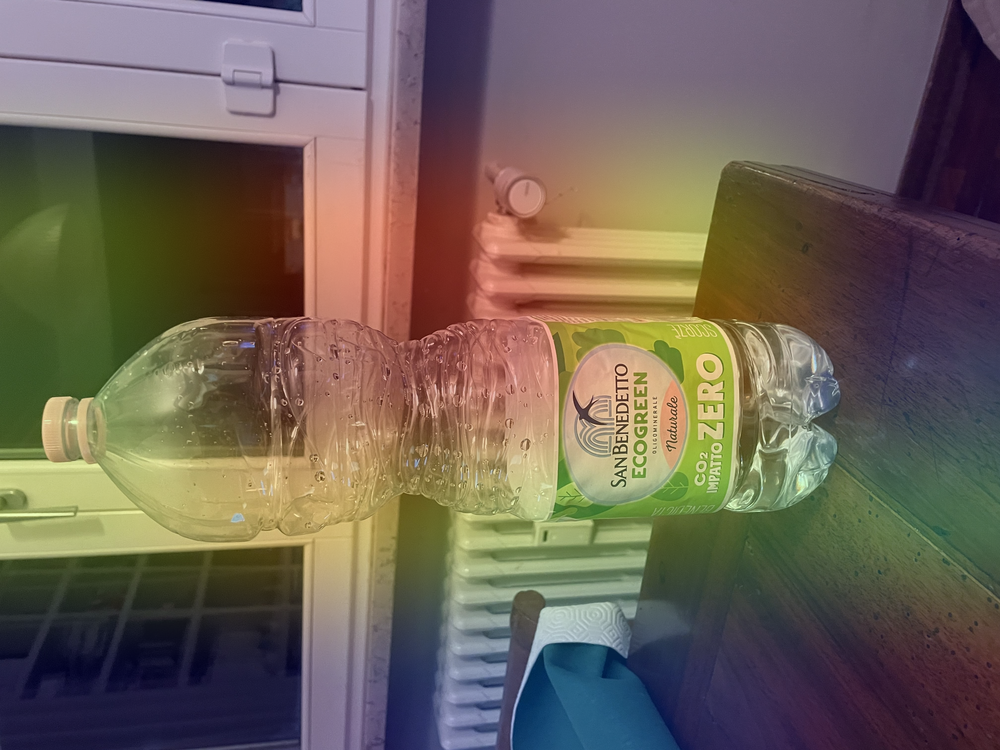

In [97]:
# Prepare image
# Remove last layer's softmax
model.layers[-1].activation = None

# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img, model)

image = keras.utils.load_img(test_img_path)
image = keras.utils.img_to_array(image)
# Rescale heatmap to a range 0-255
heatmap = np.uint8(255 * heatmap)

# Use jet colormap to colorize heatmap
jet = mlp.colormaps["jet"]

# Use RGB values of the colormap
jet_colors = jet(np.arange(256))[:, :3]
jet_heatmap = jet_colors[heatmap]

# Create an image with RGB colorized heatmap
jet_heatmap = keras.utils.array_to_img(jet_heatmap)
jet_heatmap = jet_heatmap.resize((image.shape[1], image.shape[0]))
jet_heatmap = keras.utils.img_to_array(jet_heatmap)

alpha = 0.4
# Superimpose the heatmap on original image
superimposed_img = jet_heatmap * alpha + image

superimposed_img = keras.utils.array_to_img(superimposed_img)

# Save the superimposed image
#superimposed_img.save(cam_path)

# Display Grad CAM
display(superimposed_img)